# Load the required modules

Firstly, we have to load the required modules from the SAnTex package. This ensures that the methods which are written in the package are avaiable throughout the notebook

In [1]:
import numpy as np
from santex import EBSD
from santex import Tensor
from santex import Anisotropy
from santex import Material

In this code snippet, we are importing necessary modules for various functionalities. numpy is imported as np, a widely used library for numerical operations in Python. The santex module is imported four times, each time importing a different sub-module: EBSD, Tensor, Anisotropy, and Material.

EBSD contains codes for analyzing EBSD (Electron Backscatter Diffraction) files, which are used to study crystallographic properties of materials.
Tensor holds codes for tensor operations, which deals with the elastic stiffness tensors of the materials.
Anisotropy module is responsible for calculating seismic anisotropy, a property related to the variation of seismic wave speed in different directions within a material.
Material refers to a catalogue of minerals or materials present in a library, possibly used for referencing or analyzing material properties.
By importing these modules, we gain access to pre-written functions and tools that facilitate the respective analyses and operations mentioned above.

# Load the ebsd ctf file

Let's load an EBSD file. For loading the EBSD file, we need to use EBSD module to load an EBSD file written in ctf format. For this notebook, we are using "ebsd.ctf" which is stored in the same directory as this notebook. But you may place the file in another location, for e.g. data/ebsd.ctf and for loading that ebsd file, we need to use ebsd = EBSD("data/ebsd.ctf")

In [2]:
ebsd = EBSD("ebsd.ctf")

# Get the available phases information

Let's check what are the phases information present in the ebsd file

In [3]:
x = ebsd.phases()

print(x)

+---------+------------+--------------+
|   Index | Phase      |   Percentage |
+=========+============+==============+
|       0 | NaN        |     23.779   |
+---------+------------+--------------+
|       1 | Forsterite |     61.9409  |
+---------+------------+--------------+
|       2 | Enstatite  |     10.5948  |
+---------+------------+--------------+
|       3 | Diopside   |      3.68527 |
+---------+------------+--------------+


Let's check the phases abundence in the particular ebsd file

In [4]:
phases_data = ebsd.phases_data

phases_data

[(0, 'NaN', 23.77903005464481),
 (1, 'Forsterite', 61.94094782721832),
 (2, 'Enstatite', 10.594750195160032),
 (3, 'Diopside', 3.6852719229768414)]

# Load the ebsd file in a dataframe

A brief introduction to what an EBSD file is:
An EBSD file is a data file used in materials science to store information about the microscopic structure of materials, particularly focusing on crystallographic properties. Within this file, Euler Bunge Angles (Phi1, Phi, Phi2) describe the orientation of crystals within the material, akin to longitude, latitude, and rotation for Earth but at a microscopic scale. The Mean Angular Deviation (MAD) measures how much individual crystal orientations deviate from the average, providing insights into the material's structural consistency. Coordinates X and Y pinpoint specific positions within the material, while 'Phase' distinguishes different regions with unique properties, such as varying crystal types. Additionally, terms like 'Bands,' 'Error,' 'BC (Band Contrast),' and 'BS (Band Slope)' detail aspects like diffraction patterns, measurement quality, and intensity characteristics, all crucial for understanding the material's crystalline structure and behavior.

All these information are stored in different columns with every row representing a crystal within an EBSD map.

Let's load the ebsd data in a dataframe using the following directive ```df = ebsd.get_ebsd_data()``` and check the information

In [5]:
df = ebsd.get_ebsd_data()
df

,Phase,X,Y,Bands,Error,Euler1,Euler2,Euler3,MAD,BC,BS
0,1,0.0,0.0,7,0,95.325,42.35,293.67,0.1,138,255
1,1,50.0,0.0,7,0,95.585,42.35,293.36,0.1,134,255
2,1,100.0,0.0,7,0,95.362,42.45,293.66,0.1,137,245
3,1,150.0,0.0,7,0,95.563,42.20,293.35,0.3,140,255
4,1,200.0,0.0,7,0,95.409,42.28,293.54,0.2,136,255
...,...,...,...,...,...,...,...,...,...,...,...
245947,0,36350.0,16750.0,0,3,360.000,180.00,0.00,0.0,255,71
245948,0,36400.0,16750.0,0,3,360.000,180.00,0.00,0.0,255,55
245949,0,36450.0,16750.0,0,3,360.000,180.00,0.00,0.0,255,78
245950,0,36500.0,16750.0,0,3,360.000,180.00,0.00,0.0,227,79


Here you can see that the dataframe suggests at row 0, with a coordinate of X = 0, y = 0, or at X = 50, Y = 0, we have Phase = 1, and looking at the previous cell, we can say that the Phase 1 corresponds to Forsterite. At row 245947, we can check that it suggests Phase = 0, which suggests that its "NaN" from phases data which means thats a non indexed phase, which happens because the ebsd instrument isn't able to give a measurement at that location.

Let's look at the ebsd map and interpret further

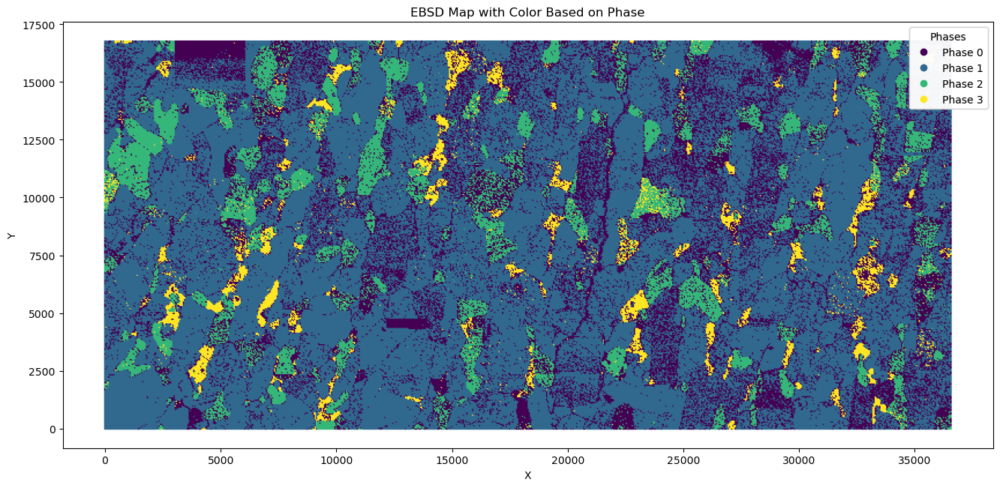

In [6]:
ebsd.plot(df, cmap = "viridis")

In the above map, we can see the coordinates of x and y and the corresponding pixels with each representing a pixels, we can be able to look which phases each pixels correspond to. Let's save the above plot with a dpi of 300, with legend plotted lower right for seeing upper right clearly

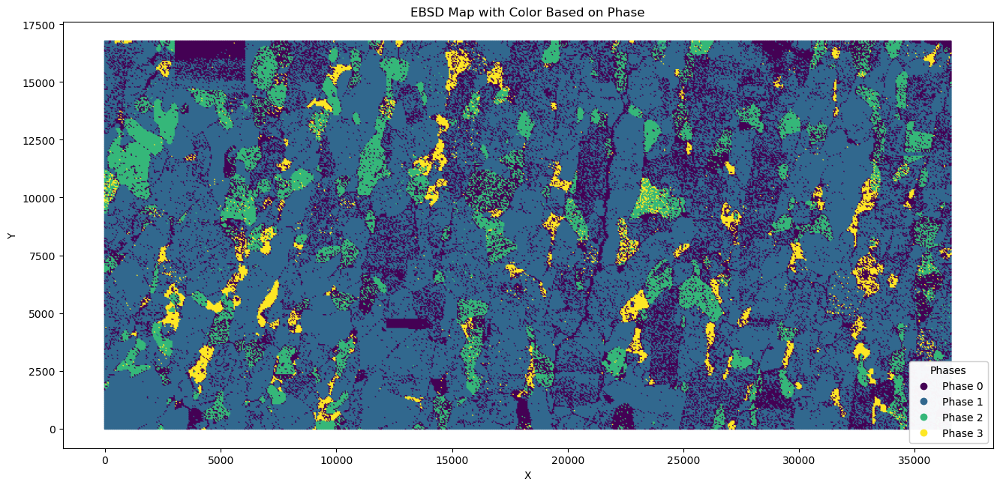

In [11]:
ebsd.plot(df, cmap = "viridis", save_image= True, image_filename= "ebsd.png", legend_location="lower right")

Now, the above plot doesnt account for the crystal symmetry. Let's look at the orientation distribution function and pole density function

Orientation Distribution Function (ODF): Think of the ODF as a way to describe how materials like metals or crystals are arranged in different directions. Imagine you're looking at a pile of stacked books from various angles. The ODF tells you how many books are stacked in each direction, helping understand the overall pattern or texture of the stack.

Pole Density Function: This is like zooming in on a specific part of the pile of books and counting how many books are stacked in a particular orientation. It gives a more detailed view of how the books are aligned in a specific area, which can be useful for studying local patterns or properties.

In simple words ODF and PDF consider crystal symmetries and a fixed sample reference

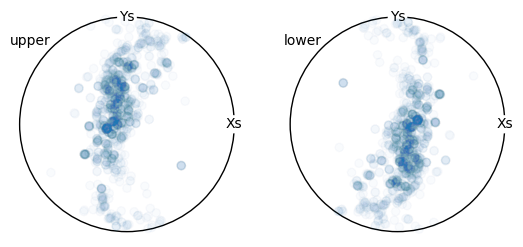

In [13]:
ebsd.odf(df)

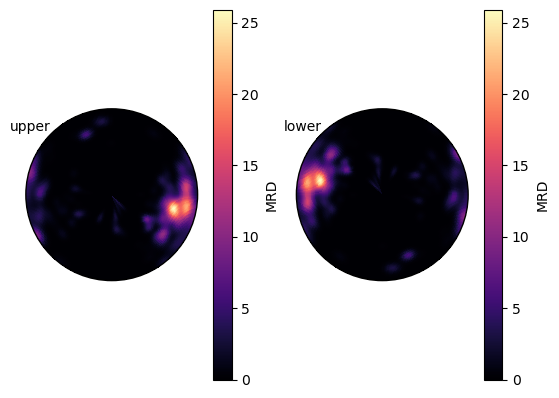

In [14]:
ebsd.pdf(df)

Lets look at inverse pole figure. Inverse pole figure fixes the crystal symmetry and looks at orientation by changing the specimen reference

Orientation (1250, 1) 222
[[[ 0.6651  0.4209 -0.4877 -0.3777]]

 [[ 0.5543  0.5717 -0.5283 -0.2946]]

 [[ 0.7833  0.3477 -0.3099 -0.4116]]

 ...

 [[ 0.3802 -0.6997 -0.5522  0.2466]]

 [[ 0.7249  0.1518 -0.3392 -0.58  ]]

 [[ 0.1492 -0.7544 -0.6376 -0.0457]]]
Vector3d (1,)
[[0 0 1]]


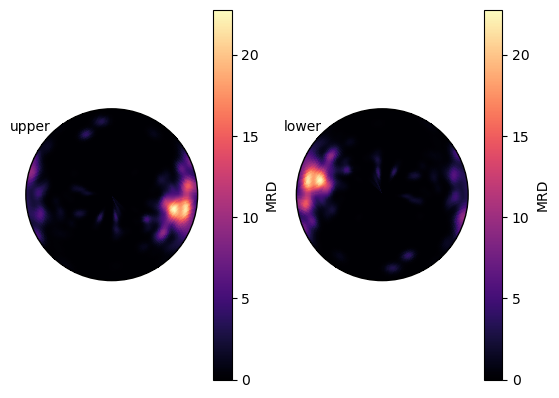

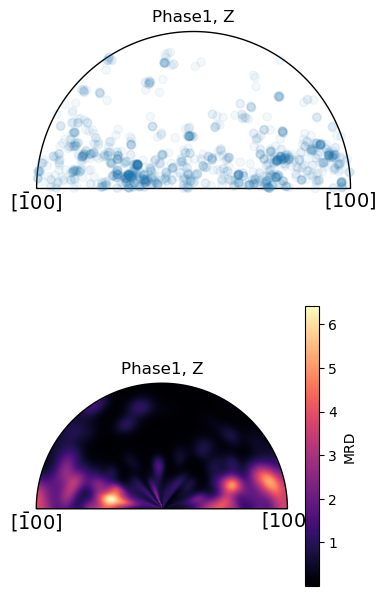

In [15]:
ebsd.ipf(df)

# Plot the ebsd file, default: x2east, zoutofplane

Lets plot the ebsd map relative to the instrument reference system. We can check the map corresponding to the odf and pdf too. 

The default plotting system ```ebsd.plot(df)``` plots x to the east and z axis out of the plane

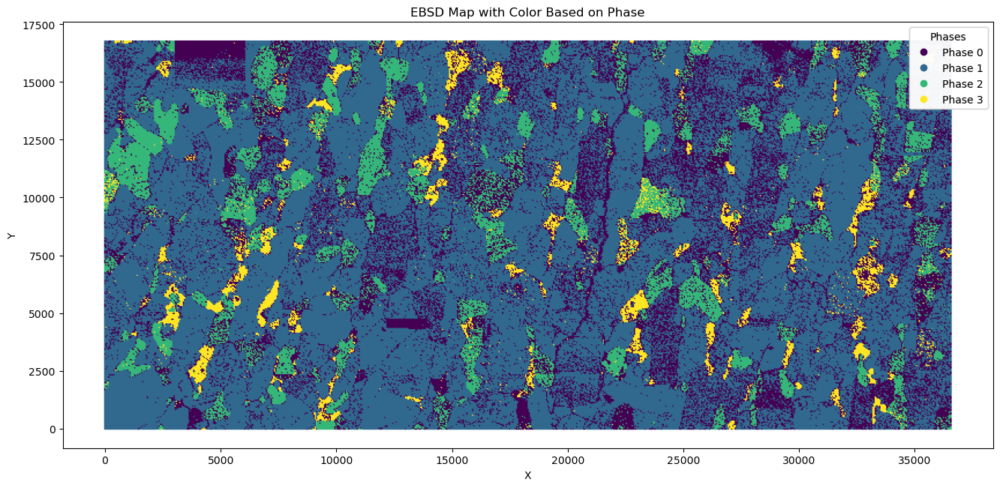

In [16]:
ebsd.plot(df)

In [7]:
## Placeholder for defining densities and stiffness tensors the traditional way


# rho_Fo = 3355
# rho_diop = 3286
# rho_ens = 3306

# cij_Fo = np.array([[320.5, 68.15, 71.6, 0, 0, 0],
#                 [68.15, 196.5, 76.8, 0, 0, 0],
#                 [71.6, 76.8, 233.5, 0, 0, 0],
#                 [0, 0, 0, 64, 0, 0],
#                 [0, 0, 0, 0, 77, 0],
#                 [0, 0, 0, 0, 0, 78.7]])
# cij_ens = np.array([[236.90, 79.60, 63.20, 0.00, 0.00, 0.00],
#                 [79.60, 180.50, 56.80, 0.00, 0.00, 0.00],
#                 [63.20, 56.80, 230.40, 0.00, 0.00, 0.00],
#                 [0.00, 0.00, 0.00, 84.30, 0.00, 0.00],
#                 [0.00, 0.00, 0.00, 0.00, 79.40, 0.00],
#                 [0.00, 0.00, 0.00, 0.00, 0.00, 80.10]])
# cij_diop = np.array([[228.10, 78.80, 70.20, 0.00, 7.90, 0.00],
#                 [78.80, 181.10, 61.10, 0.00, 5.90, 0.00],
#                 [70.20, 61.10, 245.40, 0.00, 39.70, 0.00],
#                 [0.00, 0.00, 0.00, 78.90, 0.00, 6.40],
#                 [7.90, 5.90, 39.70, 0.00, 68.20, 0.00],
#                 [0.00, 0.00, 0.00, 6.40, 0.00, 78.10]])
# cij = [cij_Fo, cij_ens, cij_diop]
# density = [rho_Fo, rho_ens, rho_diop]

# Calculate the stiffness tensors and the density at Pressure = 2GPa and Temperature = 1500 K

Now, lets import the material stiffness tensors and density at different pressure and temperature. We do this ny creating a material instance of the Material class, and then calling the ```load_density``` function and ```voigthighPT``` function of the Material class in the following way. The resultant is stored in a variable, which in this case is rho_Fo and cij_Fo, and consequently we create an array to keep these matrix and density in a different variable, here it is called cij, density

In [19]:
material_instance = Material()
rho_Fo = material_instance.load_density("Forsterite", 2, 1500)
rho_diop = material_instance.load_density("Diopside", 2, 1500)
rho_ens = material_instance.load_density("Enstatite", 2, 1500)
cij_Fo = material_instance.voigthighPT('Forsterite', PRESSURE = 2, TEMP = 1500)
cij_ens = material_instance.voigthighPT('Enstatite', PRESSURE = 2, TEMP = 1500)
cij_diop = material_instance.voigthighPT('Diopside', PRESSURE = 2, TEMP = 1500)

In [20]:
cij = [cij_Fo, cij_ens, cij_diop]
density = [rho_Fo, rho_ens, rho_diop]

# Get the euler angles from ebsd file

Now, we also obtain the euler angles corresponding to the phases whose matrix and density information we extracted above, and then store them in an array format in the variable called euler_angles

In [22]:
forsterite = ebsd.get_euler_angles(phase = 1, data=df)
enstatite = ebsd.get_euler_angles(phase = 2, data=df)
diopside = ebsd.get_euler_angles(phase = 3, data=df)
euler_angles = [forsterite, enstatite, diopside]

Lets calculate anisotropy from the ebsd file. we first calculate the average tensor and average density by giving the directive ```average_tensor, average_density = ebsd.getAnisotropyForEBSD(cij, euler_angles, density)```, and then calculate anisotropy after creating an instance of the Anisotropy class, which can be called using ```anis = Anisotropy(average_tensor*10**9, average_density)```. Afterwards we plot the anisotropy using the directive ```anis.plot()```


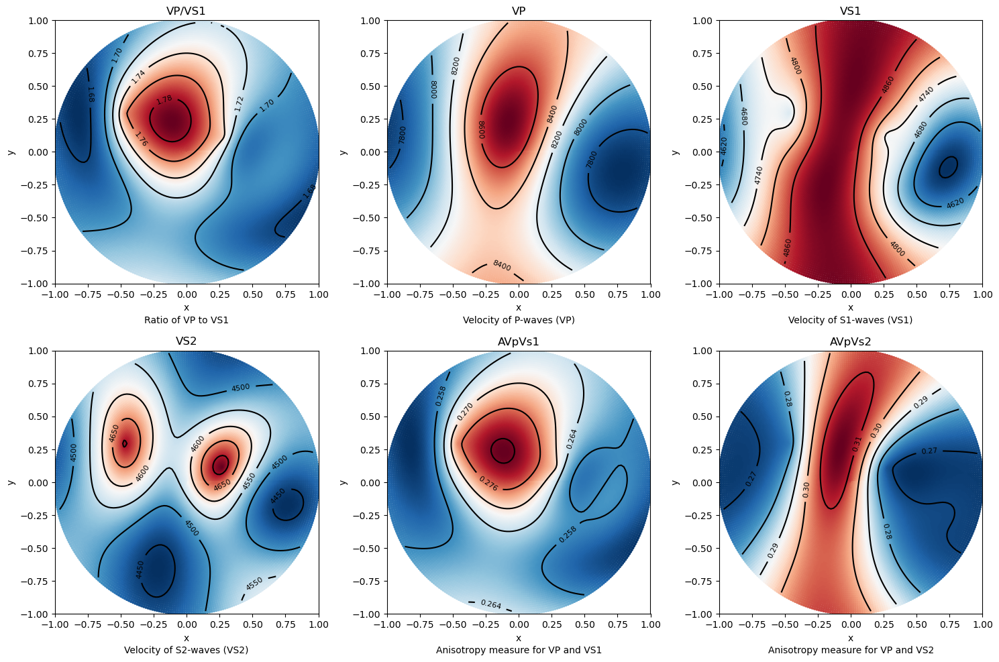

In [24]:
average_tensor, average_density = ebsd.getAnisotropyForEBSD(cij, euler_angles, density)
anis = Anisotropy(average_tensor*10**9, average_density)
anis.plot()

Now, lets calculate some values related to anisotropy measures

In [25]:
anis.anisotropy_values()

Max Vp:  8768.809478642688
Min Vp:  7726.686772702403
Max Vs1:  4912.454468483408
Min Vs1:  4555.294289337551
Max Vs2:  4725.497695859933
Min Vs2:  4441.835787546708
Max vs anisotropy percent:  9.906880996199247
Min vs anisotropy percent:  0.08437960768181517
P wave anisotropy percent:  12.635239219981727
S1 Wave anisotropy percent:  7.54477517901645
S2 Wave anisotropy percent:  6.188536913741987
Velocity difference:  463.0233810326499
Vp/Vs1 ratio:  6.551024629493794


{'maxvp': 8768.809478642688,
 'minvp': 7726.686772702403,
 'maxvs1': 4912.454468483408,
 'minvs1': 4555.294289337551,
 'maxvs2': 4725.497695859933,
 'minvs2': 4441.835787546708,
 'max_vs_anisotropy_percent': 9.906880996199247,
 'min_vs_anisotropy_percent': 0.08437960768181517,
 'p_wave_anisotropy_percent': 12.635239219981727,
 's1_wave_anisotropy_percent': 7.54477517901645,
 's2_wave_anisotropy_percent': 6.188536913741987,
 'maxdvs': 463.0233810326499,
 'AVpVs1': 6.551024629493794}

Lets look at the average tensors of all the phases

In [27]:
cij

[array([[297.72,  64.96,  71.44,   0.  ,   0.  ,   0.  ],
        [ 64.96, 175.9 ,  79.5 ,   0.  ,   0.  ,   0.  ],
        [ 71.44,  79.5 , 211.92,   0.  ,   0.  ,   0.  ],
        [  0.  ,   0.  ,   0.  ,  52.88,   0.  ,   0.  ],
        [  0.  ,   0.  ,   0.  ,   0.  ,  64.72,   0.  ],
        [  0.  ,   0.  ,   0.  ,   0.  ,   0.  ,  65.32]]),
 array([[216.74,  68.1 ,  43.22,   0.  ,   0.  ,   0.  ],
        [ 68.1 , 159.52,  61.42,   0.  ,   0.  ,   0.  ],
        [ 43.22,  61.42, 201.32,   0.  ,   0.  ,   0.  ],
        [  0.  ,   0.  ,   0.  ,  73.34,   0.  ,   0.  ],
        [  0.  ,   0.  ,   0.  ,   0.  ,  68.68,   0.  ],
        [  0.  ,   0.  ,   0.  ,   0.  ,   0.  ,  68.2 ]]),
 array([[219.06,  78.88,  76.02,   0.  ,   8.98,   0.  ],
        [ 78.88, 170.12,  56.14,   0.  ,  10.28,   0.  ],
        [ 76.02,  56.14, 212.58,   0.  ,  53.62,   0.  ],
        [  0.  ,   0.  ,   0.  ,  69.58,   0.  ,  13.1 ],
        [  8.98,  10.28,  53.62,   0.  ,  64.36,   0.  ],
        [ 

# Rotating the dataset by 90 degree around the z-axis

In [13]:
rotated = ebsdfile.rotateEBSD(df, [180, 0, 90], keepXY = False)

  0%|                                                                                                                                                                                                  | 16/245952 [00:02<13:16:28,  5.15it/s]/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/satex/ebsd/rotateEBSD.py:78: UserWarning: Gimbal lock detected. Setting third angle to zero since it is not possible to uniquely determine all angles.
  phi1_res, Phi_res, phi2_res = resultant_rot.as_euler('zxz', degrees=True)
/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/satex/ebsd/rotateEBSD.py:78: UserWarning: Gimbal lock detected. Setting third angle to zero since it is not possible to uniquely determine all angles.
  phi1_res, Phi_res, phi2_res = resultant_rot.as_euler('zxz', degrees=True)
/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/satex/ebsd/rotateEBSD.py:78: UserWarning: Gimbal lock detected. Setting third angle to zero since it is not po

In [14]:
rotated

,Phase,X,Y,Bands,Error,Euler1,Euler2,Euler3,MAD,BC,BS
0,1,0.000000e+00,0.0,7,0,5.325,42.35,293.67,0.1,138,255
1,1,-1.110223e-14,-50.0,7,0,5.585,42.35,293.36,0.1,134,255
2,1,-2.220446e-14,-100.0,7,0,5.362,42.45,293.66,0.1,137,245
3,1,-3.330669e-14,-150.0,7,0,5.563,42.20,293.35,0.3,140,255
4,1,-4.440892e-14,-200.0,7,0,5.409,42.28,293.54,0.2,136,255
...,...,...,...,...,...,...,...,...,...,...,...
245947,0,1.675000e+04,-36350.0,0,3,270.000,180.00,0.00,0.0,255,71
245948,0,1.675000e+04,-36400.0,0,3,270.000,180.00,0.00,0.0,255,55
245949,0,1.675000e+04,-36450.0,0,3,270.000,180.00,0.00,0.0,255,78
245950,0,1.675000e+04,-36500.0,0,3,270.000,180.00,0.00,0.0,227,79


In [15]:
forsterite = ebsdfile.get_euler_angles(phase = 1, data=rotated)
enstatite = ebsdfile.get_euler_angles(phase = 2, data=rotated)
diopside = ebsdfile.get_euler_angles(phase = 3, data=rotated)
euler_angles = [forsterite, enstatite, diopside]

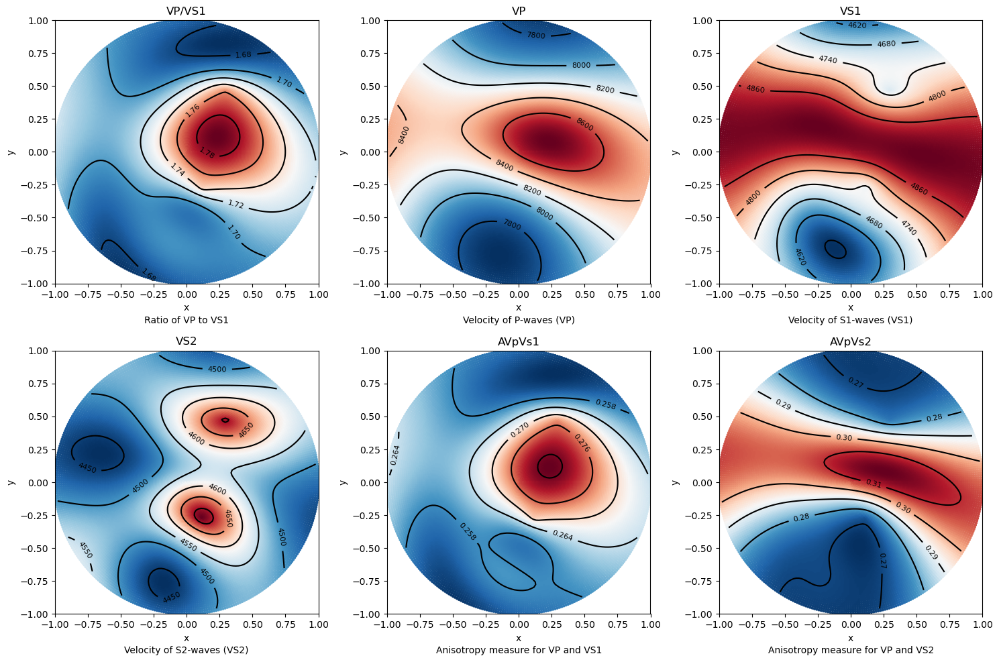

In [16]:
average_tensor, average_density = ebsdfile.getAnisotropyForEBSD(cij, euler_angles, density)
anis = Anisotropy(average_tensor*10**9, average_density)
anis.plot()

In [17]:
anis.anisotropy_values()

Max Vp:  8768.80947864269
Min Vp:  7726.686772702399
Max Vs1:  4912.454468483408
Min Vs1:  4555.294289337551
Max Vs2:  4725.497695859932
Min Vs2:  4441.835787546708
Max vs anisotropy percent:  9.906880996199265
Min vs anisotropy percent:  0.08437960768179593
P wave anisotropy percent:  12.635239219981798
S1 Wave anisotropy percent:  7.54477517901645
S2 Wave anisotropy percent:  6.1885369137419675
Velocity difference:  463.02338103265083
Vp/Vs1 ratio:  6.5510246294937575


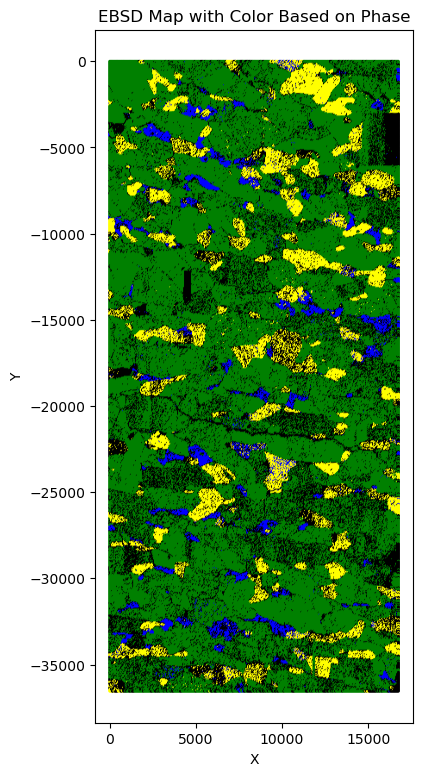

In [18]:
ebsdfile.plot(rotated)

# Rotating ebsd for matching SEM orientation

In [19]:
ebsdfile = EBSD("ebsd.ctf")
df = ebsdfile.get_ebsd_data()


In [20]:
rotated_df = ebsdfile.plot_rotate_ebsd(sample_ref = ["x2south", "zIntoPlane"], ebsd_df = df, keepXY = True)

  0%|                                                                                                                                                                                                              | 0/245952 [00:00<?, ?it/s]/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/satex/ebsd/rotateEBSD.py:78: UserWarning: Gimbal lock detected. Setting third angle to zero since it is not possible to uniquely determine all angles.
  phi1_res, Phi_res, phi2_res = resultant_rot.as_euler('zxz', degrees=True)
/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/satex/ebsd/rotateEBSD.py:78: UserWarning: Gimbal lock detected. Setting third angle to zero since it is not possible to uniquely determine all angles.
  phi1_res, Phi_res, phi2_res = resultant_rot.as_euler('zxz', degrees=True)
/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/satex/ebsd/rotateEBSD.py:78: UserWarning: Gimbal lock detected. Setting third angle to zero since it is not po

In [21]:
rotated_df

,Phase,X,Y,Bands,Error,Euler1,Euler2,Euler3,MAD,BC,BS
0,1,0.0,0.0,7,0,174.675,137.65,113.67,0.1,138,255
1,1,50.0,0.0,7,0,174.415,137.65,113.36,0.1,134,255
2,1,100.0,0.0,7,0,174.638,137.55,113.66,0.1,137,245
3,1,150.0,0.0,7,0,174.437,137.80,113.35,0.3,140,255
4,1,200.0,0.0,7,0,174.591,137.72,113.54,0.2,136,255
...,...,...,...,...,...,...,...,...,...,...,...
245947,0,36350.0,16750.0,0,3,90.000,0.00,0.00,0.0,255,71
245948,0,36400.0,16750.0,0,3,90.000,0.00,0.00,0.0,255,55
245949,0,36450.0,16750.0,0,3,90.000,0.00,0.00,0.0,255,78
245950,0,36500.0,16750.0,0,3,90.000,0.00,0.00,0.0,227,79


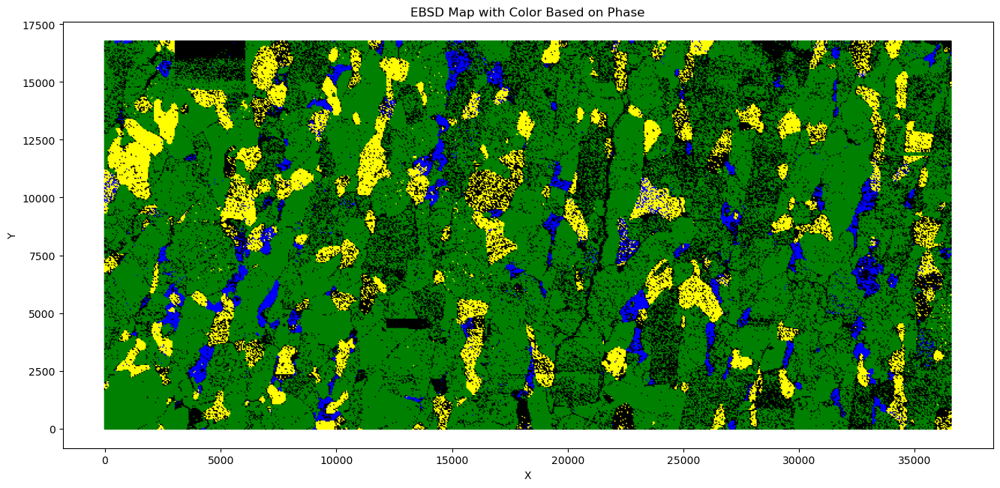

In [22]:
ebsdfile.plot(rotated_df)

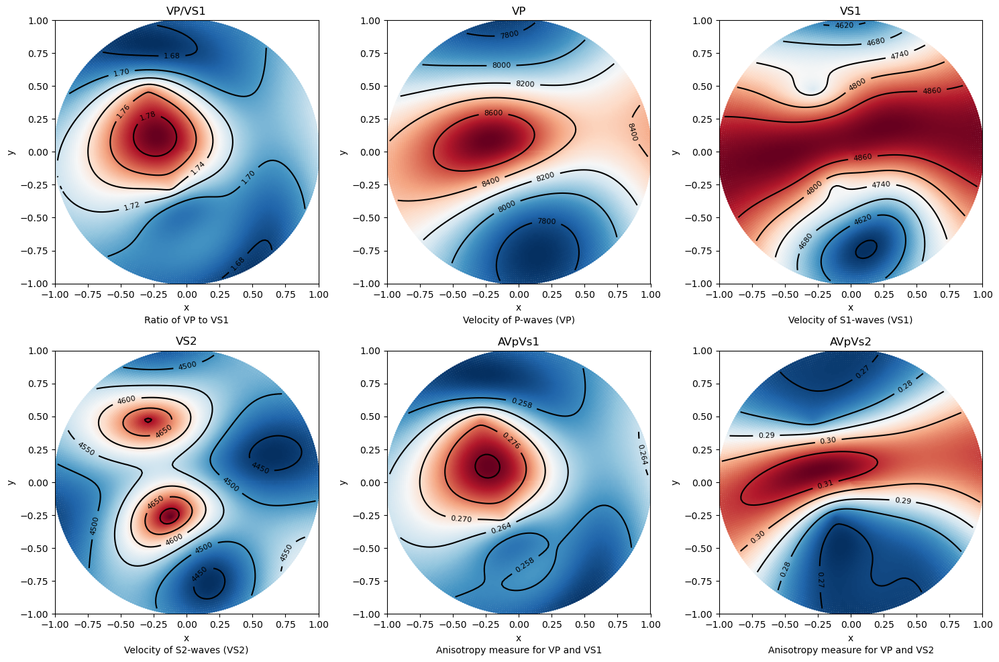

In [23]:
forsterite = ebsdfile.get_euler_angles(phase = 1, data=rotated_df)
enstatite = ebsdfile.get_euler_angles(phase = 2, data=rotated_df)
diopside = ebsdfile.get_euler_angles(phase = 3, data=rotated_df)
euler_angles = [forsterite, enstatite, diopside]

average_tensor, average_density = ebsdfile.getAnisotropyForEBSD(cij, euler_angles, density)
anis = Anisotropy(average_tensor*10**9, average_density)
anis.plot()

In [24]:
anis.anisotropy_values()

Max Vp:  8768.809478642688
Min Vp:  7726.686772702397
Max Vs1:  4912.45446848341
Min Vs1:  4555.294289337551
Max Vs2:  4725.497695859933
Min Vs2:  4441.835787546708
Max vs anisotropy percent:  9.906880996199268
Min vs anisotropy percent:  0.08437960768183442
P wave anisotropy percent:  12.6352392199818
S1 Wave anisotropy percent:  7.5447751790164865
S2 Wave anisotropy percent:  6.188536913741987
Velocity difference:  463.02338103265083
Vp/Vs1 ratio:  6.5510246294937415


In [25]:
ebsdfile = EBSD("ebsd.ctf")
df = ebsdfile.get_ebsd_data()

/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/matplotlib/collections.py:1109: UserWarning: Collection without array used. Make sure to specify the values to be colormapped via the `c` argument.
  warnings.warn("Collection without array used. Make sure to "


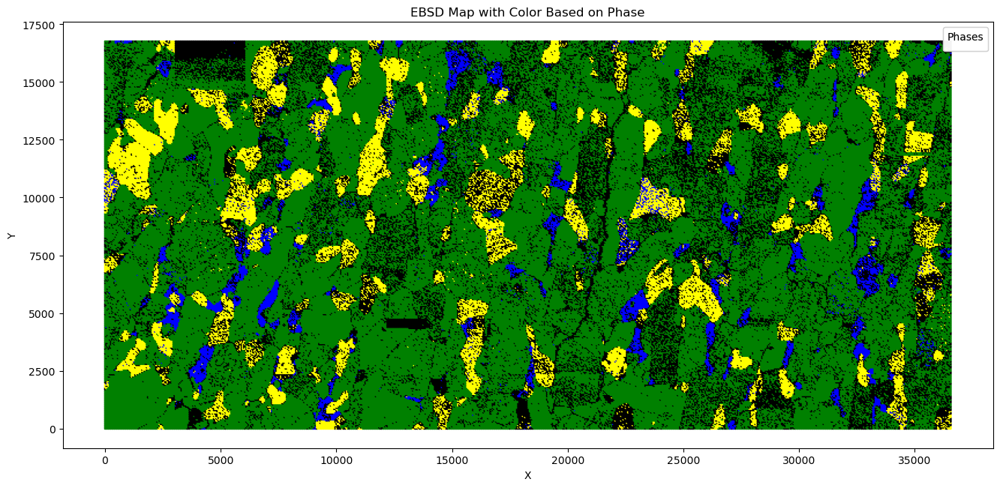

In [7]:
ebsd.plot(rotation_angle=0)

/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/matplotlib/collections.py:1109: UserWarning: Collection without array used. Make sure to specify the values to be colormapped via the `c` argument.
  warnings.warn("Collection without array used. Make sure to "


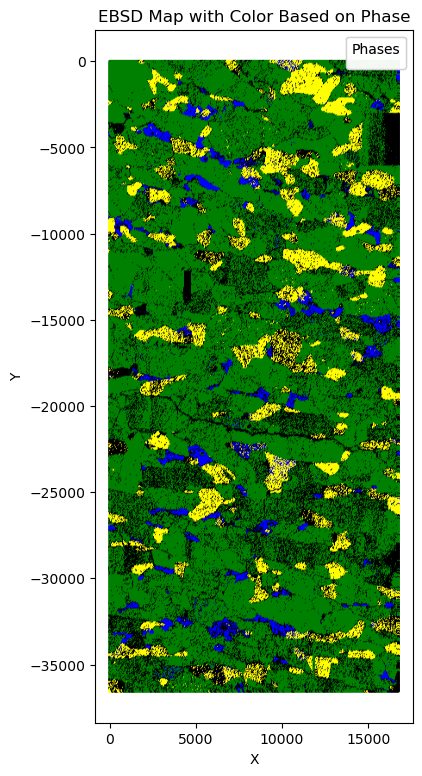

In [9]:
ebsd.plot(rotation_angle=90)

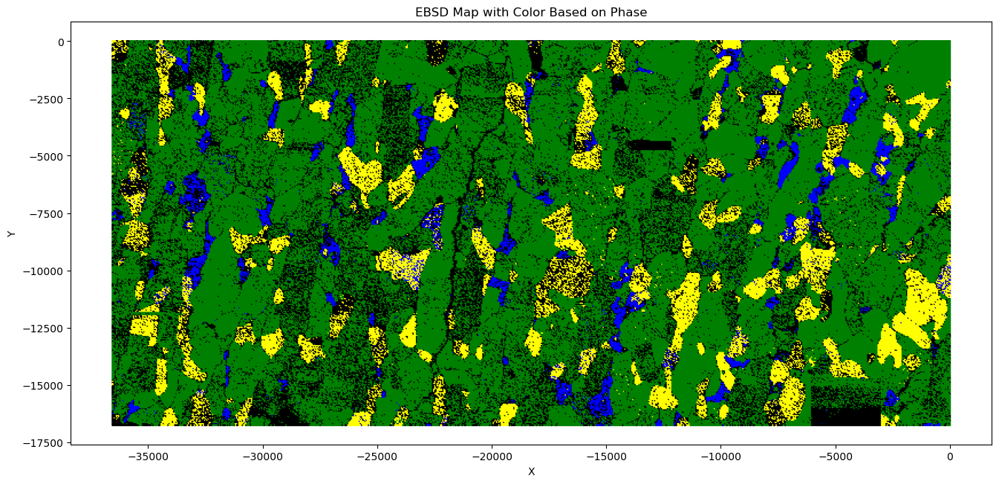

In [28]:
ebsdfile.plot(rotation_angle=180)

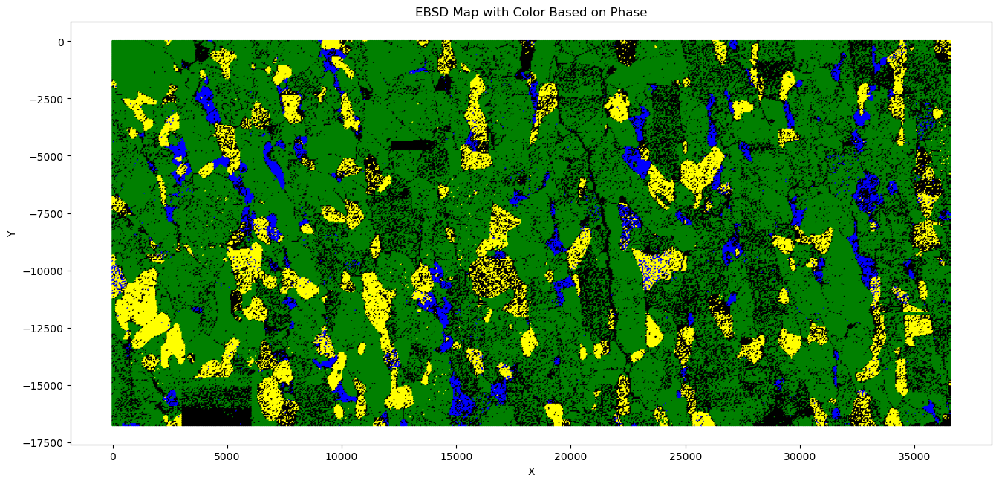

In [29]:
ebsdfile.plot(rotation_angle=180, mirror=True)

In [30]:
ebsdfile = EBSD("ebsd.ctf")

df = ebsdfile.get_ebsd_data()

In [31]:
rotated = ebsdfile.rotateEBSD(df, [70, 160, 50], keepXY = False)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 245952/245952 [00:15<00:00, 15760.58it/s]


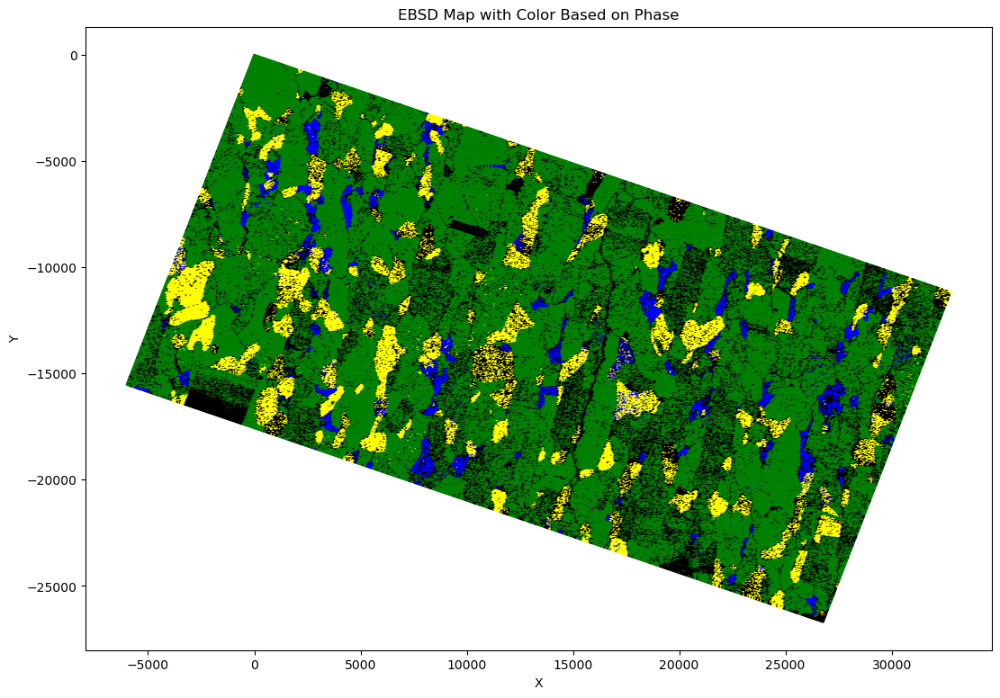

In [32]:
ebsdfile.plot(rotated)

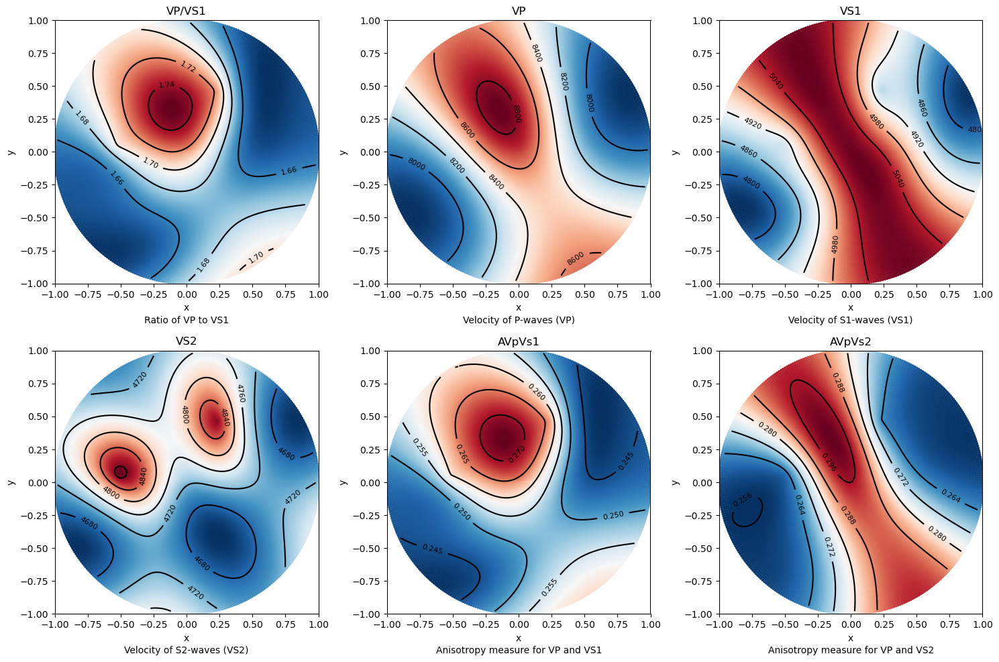

In [33]:
rotated_df = rotated

rho_Fo = 3355
rho_diop = 3286
rho_ens = 3306

cij_Fo = np.array([[320.5, 68.15, 71.6, 0, 0, 0],
                [68.15, 196.5, 76.8, 0, 0, 0],
                [71.6, 76.8, 233.5, 0, 0, 0],
                [0, 0, 0, 64, 0, 0],
                [0, 0, 0, 0, 77, 0],
                [0, 0, 0, 0, 0, 78.7]])
cij_ens = np.array([[236.90, 79.60, 63.20, 0.00, 0.00, 0.00],
                [79.60, 180.50, 56.80, 0.00, 0.00, 0.00],
                [63.20, 56.80, 230.40, 0.00, 0.00, 0.00],
                [0.00, 0.00, 0.00, 84.30, 0.00, 0.00],
                [0.00, 0.00, 0.00, 0.00, 79.40, 0.00],
                [0.00, 0.00, 0.00, 0.00, 0.00, 80.10]])
cij_diop = np.array([[228.10, 78.80, 70.20, 0.00, 7.90, 0.00],
                [78.80, 181.10, 61.10, 0.00, 5.90, 0.00],
                [70.20, 61.10, 245.40, 0.00, 39.70, 0.00],
                [0.00, 0.00, 0.00, 78.90, 0.00, 6.40],
                [7.90, 5.90, 39.70, 0.00, 68.20, 0.00],
                [0.00, 0.00, 0.00, 6.40, 0.00, 78.10]])
cij = [cij_Fo, cij_ens, cij_diop]
density = [rho_Fo, rho_ens, rho_diop]

forsterite = ebsdfile.get_euler_angles(phase = 1, data=rotated_df)
enstatite = ebsdfile.get_euler_angles(phase = 2, data=rotated_df)
diopside = ebsdfile.get_euler_angles(phase = 3, data=rotated_df)
euler_angles = [forsterite, enstatite, diopside]

average_tensor, average_density = ebsdfile.getAnisotropyForEBSD(cij, euler_angles, density)
anis = Anisotropy(average_tensor*10**9, average_density)
anis.plot()

# Cleaning EBSD data

In [34]:
ebsdfile = EBSD("ebsd.ctf")

In [35]:
phases_available = ebsdfile.phases()
print(phases_available)


+---------+------------+--------------+
|   Index | Phase      |   Percentage |
+=========+============+==============+
|       0 | NaN        |     23.779   |
+---------+------------+--------------+
|       1 | Forsterite |     61.9409  |
+---------+------------+--------------+
|       2 | Enstatite  |     10.5948  |
+---------+------------+--------------+
|       3 | Diopside   |      3.68527 |
+---------+------------+--------------+


In [36]:
df = ebsdfile.get_ebsd_data()

In [37]:
df

,Phase,X,Y,Bands,Error,Euler1,Euler2,Euler3,MAD,BC,BS
0,1,0.0,0.0,7,0,95.325,42.35,293.67,0.1,138,255
1,1,50.0,0.0,7,0,95.585,42.35,293.36,0.1,134,255
2,1,100.0,0.0,7,0,95.362,42.45,293.66,0.1,137,245
3,1,150.0,0.0,7,0,95.563,42.20,293.35,0.3,140,255
4,1,200.0,0.0,7,0,95.409,42.28,293.54,0.2,136,255
...,...,...,...,...,...,...,...,...,...,...,...
245947,0,36350.0,16750.0,0,3,360.000,180.00,0.00,0.0,255,71
245948,0,36400.0,16750.0,0,3,360.000,180.00,0.00,0.0,255,55
245949,0,36450.0,16750.0,0,3,360.000,180.00,0.00,0.0,255,78
245950,0,36500.0,16750.0,0,3,360.000,180.00,0.00,0.0,227,79


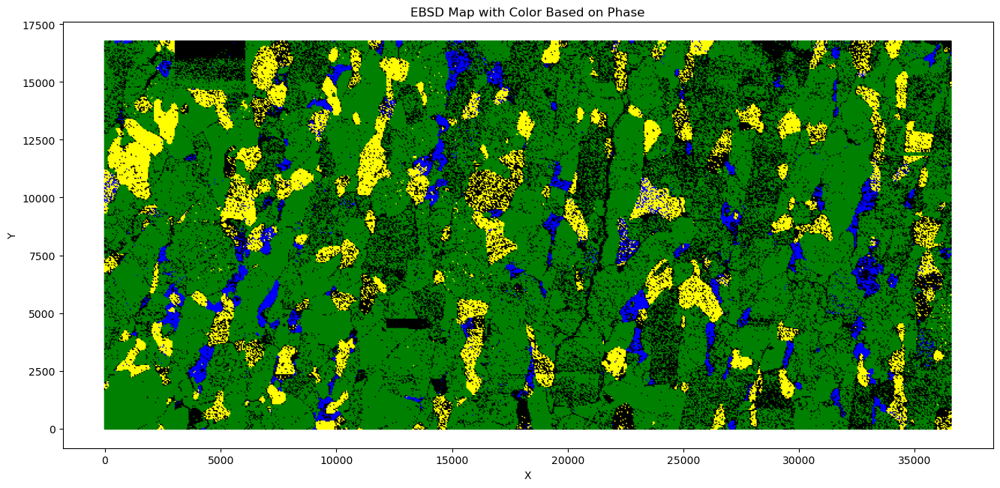

In [38]:
ebsdfile.plot(df)

# Removing data with MAD < 0.7

In [39]:
filtered_df = df[df['MAD'] < 0.7]
print(filtered_df)

        Phase        X        Y  Bands  Error   Euler1  Euler2  Euler3  MAD  \
0           1      0.0      0.0      7      0   95.325   42.35  293.67  0.1   
1           1     50.0      0.0      7      0   95.585   42.35  293.36  0.1   
2           1    100.0      0.0      7      0   95.362   42.45  293.66  0.1   
3           1    150.0      0.0      7      0   95.563   42.20  293.35  0.3   
4           1    200.0      0.0      7      0   95.409   42.28  293.54  0.2   
...       ...      ...      ...    ...    ...      ...     ...     ...  ...   
245947      0  36350.0  16750.0      0      3  360.000  180.00    0.00  0.0   
245948      0  36400.0  16750.0      0      3  360.000  180.00    0.00  0.0   
245949      0  36450.0  16750.0      0      3  360.000  180.00    0.00  0.0   
245950      0  36500.0  16750.0      0      3  360.000  180.00    0.00  0.0   
245951      0  36550.0  16750.0      0      3  360.000  180.00    0.00  0.0   

         BC   BS  
0       138  255  
1       134  

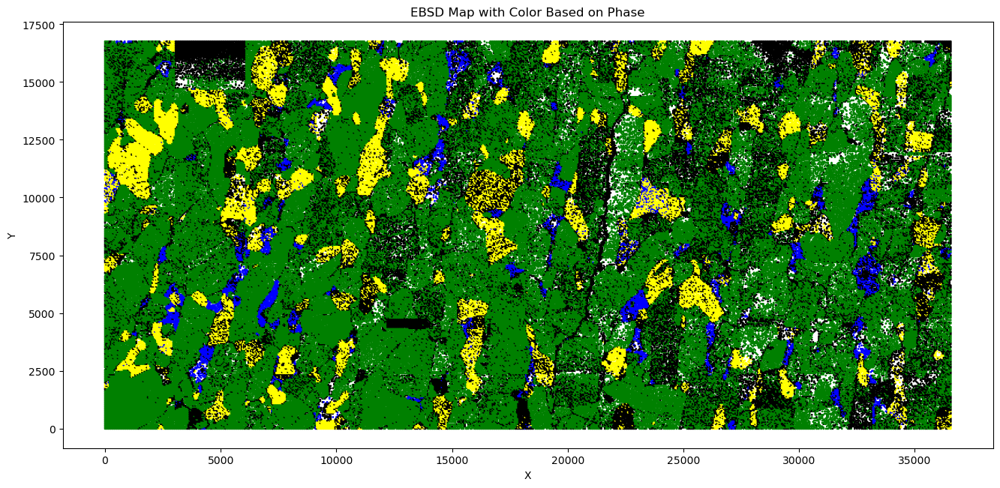

In [40]:
ebsdfile.plot(filtered_df)

# Calculating grain boundaries with threshold of 10 degrees misorientation

Grain 0: Dominant Phase - Forsterite, Size - 2546
Grain 1: Dominant Phase - Forsterite, Size - 2059
Grain 2: Dominant Phase - Enstatite, Size - 16
Grain 3: Dominant Phase - Forsterite, Size - 6482
Grain 4: Dominant Phase - Forsterite, Size - 2524
Grain 5: Dominant Phase - Enstatite, Size - 152
Grain 6: Dominant Phase - Forsterite, Size - 5973
Grain 7: Dominant Phase - Forsterite, Size - 972
Grain 8: Dominant Phase - Forsterite, Size - 451
Grain 9: Dominant Phase - Forsterite, Size - 2219
Grain 10: Dominant Phase - Forsterite, Size - 3694
Grain 11: Dominant Phase - Diopside, Size - 56
Grain 12: Dominant Phase - Enstatite, Size - 122
Grain 13: Dominant Phase - Enstatite, Size - 24
Grain 14: Dominant Phase - Forsterite, Size - 268
Grain 15: Dominant Phase - Forsterite, Size - 646
Grain 16: Dominant Phase - Forsterite, Size - 6465
Grain 17: Dominant Phase - Forsterite, Size - 1205
Grain 18: Dominant Phase - Forsterite, Size - 2632
Grain 19: Dominant Phase - Forsterite, Size - 27
Grain 20: 

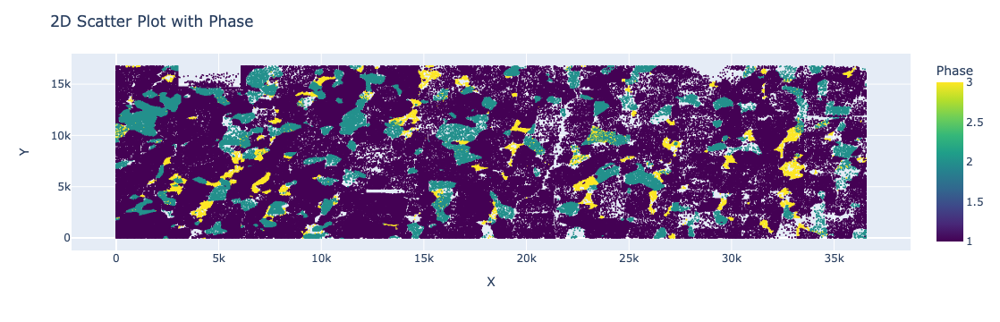

In [41]:
phases_names = ebsdfile.phases_names()
phases_names = phases_names['phase'].tolist()
phases_names.insert(0, "na")

df_grain_boundary = ebsdfile.calcGrains(df = filtered_df, threshold = 10, phase_names=phases_names, downsampling_factor=1)

# Removing grains with grain size less than 10 pixels

Grain 0: Dominant Phase - Forsterite, Size - 2546
Grain 1: Dominant Phase - Forsterite, Size - 2059
Grain 2: Dominant Phase - Enstatite, Size - 16
Grain 3: Dominant Phase - Forsterite, Size - 6482
Grain 4: Dominant Phase - Forsterite, Size - 2524
Grain 5: Dominant Phase - Enstatite, Size - 152
Grain 6: Dominant Phase - Forsterite, Size - 5973
Grain 7: Dominant Phase - Forsterite, Size - 972
Grain 8: Dominant Phase - Forsterite, Size - 451
Grain 9: Dominant Phase - Forsterite, Size - 2219
Grain 10: Dominant Phase - Forsterite, Size - 3694
Grain 11: Dominant Phase - Diopside, Size - 56
Grain 12: Dominant Phase - Enstatite, Size - 122
Grain 13: Dominant Phase - Enstatite, Size - 24
Grain 14: Dominant Phase - Forsterite, Size - 268
Grain 15: Dominant Phase - Forsterite, Size - 646
Grain 16: Dominant Phase - Forsterite, Size - 6465
Grain 17: Dominant Phase - Forsterite, Size - 1205
Grain 18: Dominant Phase - Forsterite, Size - 2632
Grain 19: Dominant Phase - Forsterite, Size - 27
Grain 20: 

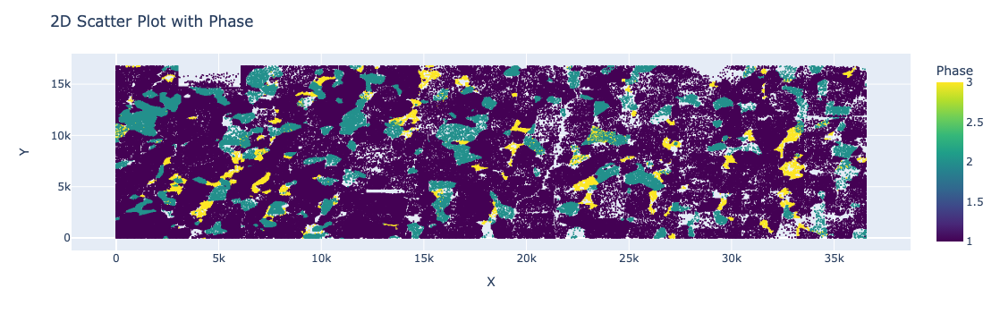

In [42]:
filtered_df_grain_boundary = ebsdfile.filterByGrainSize(df_grain_boundary, phases_names, min_grain_size=10)

In [43]:
len(df)

245952

In [44]:
len(filtered_df)

207242

In [45]:
len(filtered_df_grain_boundary)

148189

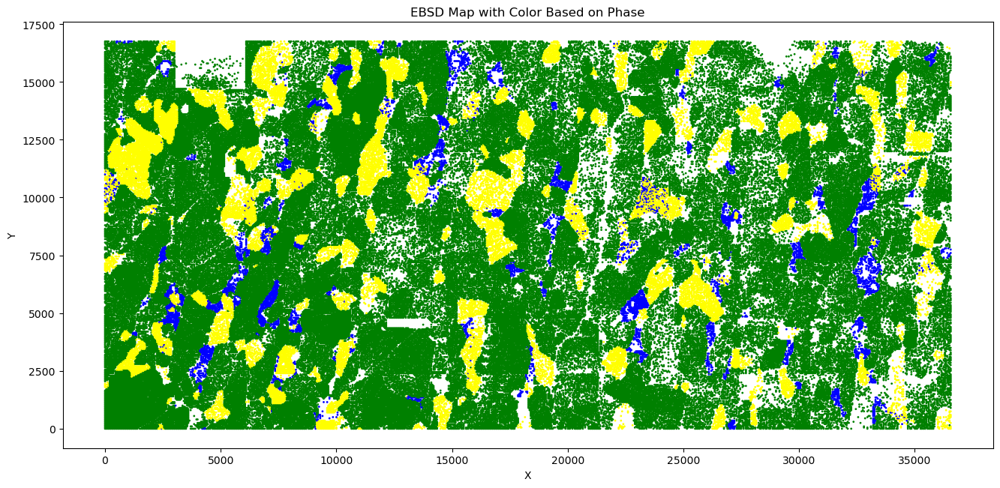

In [46]:
ebsdfile.plot(filtered_df_grain_boundary)

# Calculating Anisotropy

In [47]:
material_instance = Material()
rho_Fo = material_instance.load_density("Forsterite", 2, 1500)
rho_diop = material_instance.load_density("Diopside", 2, 1500)
rho_ens = material_instance.load_density("Enstatite", 2, 1500)
cij_Fo = material_instance.voigthighPT('Forsterite', PRESSURE = 2, TEMP = 1500)
cij_ens = material_instance.voigthighPT('Enstatite', PRESSURE = 2, TEMP = 1500)
cij_diop = material_instance.voigthighPT('Diopside', PRESSURE = 2, TEMP = 1500)

In [48]:
cij = [cij_Fo, cij_ens, cij_diop]
density = [rho_Fo, rho_ens, rho_diop]

In [49]:
forsterite = ebsdfile.get_euler_angles(phase = 1, data=filtered_df_grain_boundary)
enstatite = ebsdfile.get_euler_angles(phase = 2, data=filtered_df_grain_boundary)
diopside = ebsdfile.get_euler_angles(phase = 3, data=filtered_df_grain_boundary)
euler_angles = [forsterite, enstatite, diopside]

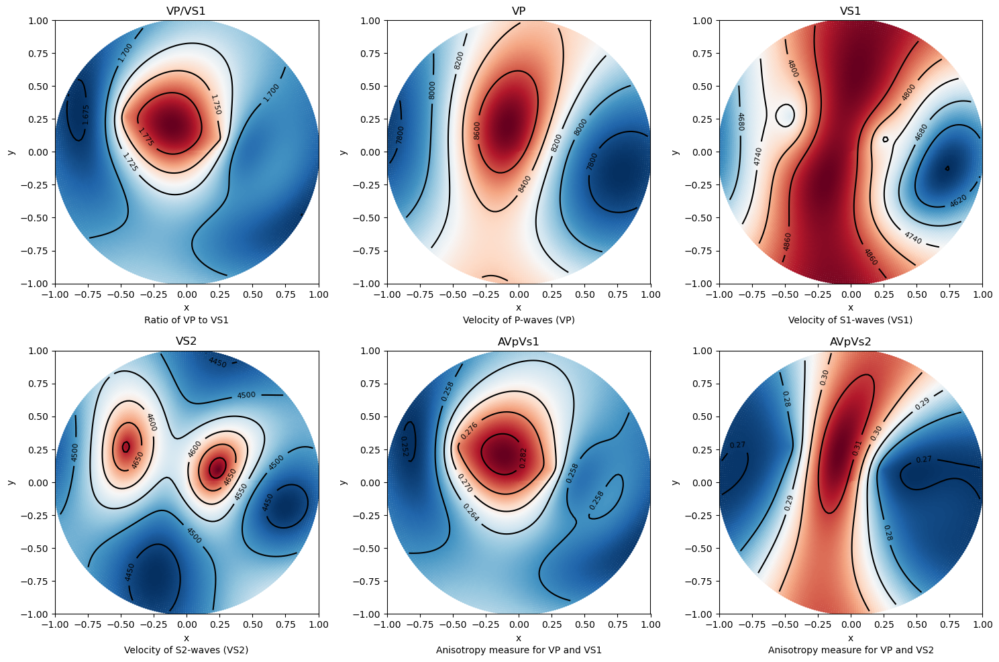

In [50]:
average_tensor, average_density = ebsdfile.getAnisotropyForEBSD(cij, euler_angles, density)
anis = Anisotropy(average_tensor*10**9, average_density)
anis.plot()

In [51]:
anis.anisotropy_values()

Max Vp:  8795.630224248014
Min Vp:  7731.533366361486
Max Vs1:  4917.936683913506
Min Vs1:  4559.675592229978
Max Vs2:  4732.600933254838
Min Vs2:  4434.6707836522755
Max vs anisotropy percent:  9.987074567526037
Min vs anisotropy percent:  0.05013385932451977
P wave anisotropy percent:  12.876944698376839
S1 Wave anisotropy percent:  7.560155052667075
S2 Wave anisotropy percent:  6.499865146422854
Velocity difference:  466.19703860546906
Vp/Vs1 ratio:  7.0453259817648455


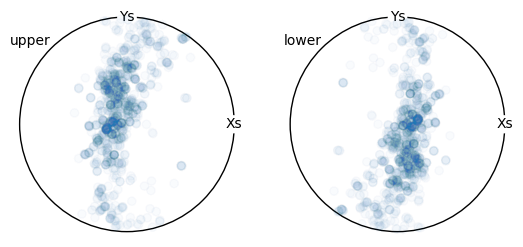

In [6]:
ebsdfile.odf(df)

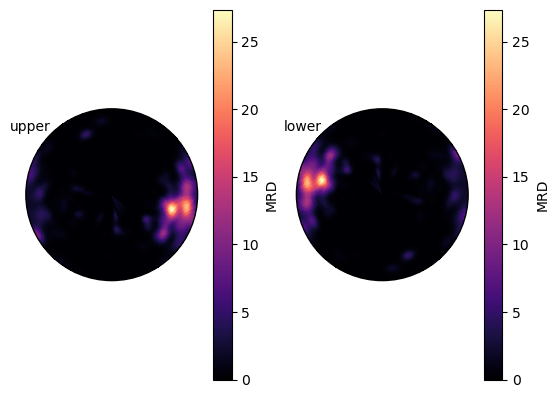

In [7]:
ebsdfile.pdf(df)

Orientation (1250, 1) 222
[[[ 0.8332  0.3834 -0.3751  0.1342]]

 [[ 0.69    0.4581 -0.5552 -0.0764]]

 [[ 0.7286  0.3504 -0.2918 -0.5111]]

 ...

 [[ 0.7657  0.3724 -0.5026  0.1495]]

 [[ 0.1844 -0.6397 -0.7358 -0.1242]]

 [[ 0.5286  0.4408 -0.5792 -0.4369]]]
Vector3d (1,)
[[0 0 1]]


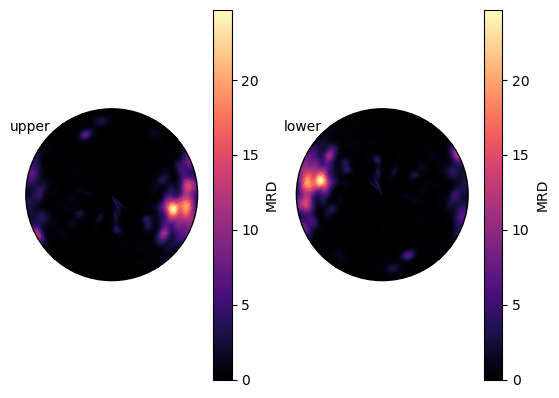

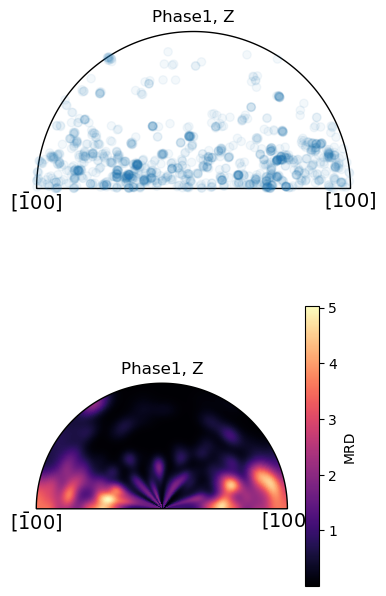

In [8]:
ebsdfile.ipf(df)

In [15]:
from santex import Anisotropy